In [1]:
import numpy as np
import healpy as hp
import matplotlib.pyplot as plt

import pandas as pd
from IPython.display import display, HTML
from astropy.cosmology import FlatLambdaCDM
import astropy.units as u

import pickle

with open('maps_2048.pkl', 'rb') as f:
    data = pickle.load(f)

In [2]:
desy3_1 = data[1]['kE'] #hp.read_map('KS_kE_maps/desy3_kE_bin1.fits')
desy3_2 = data[2]['kE'] #hp.read_map('KS_kE_maps/desy3_kE_bin2.fits')
desy3_3 = data[3]['kE'] #hp.read_map('KS_kE_maps/desy3_kE_bin3.fits')
desy3_4 = data[4]['kE'] #hp.read_map('KS_kE_maps/desy3_kE_bin4.fits')
ks_full = hp.read_map('maps2/KS_full.fits')
xray_map = hp.read_map('RASS_1_2048.fits')
desy3 = [desy3_1, desy3_2, desy3_3, desy3_4, ks_full, xray_map]

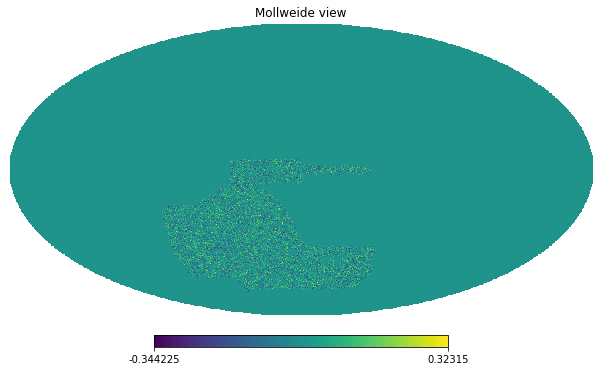

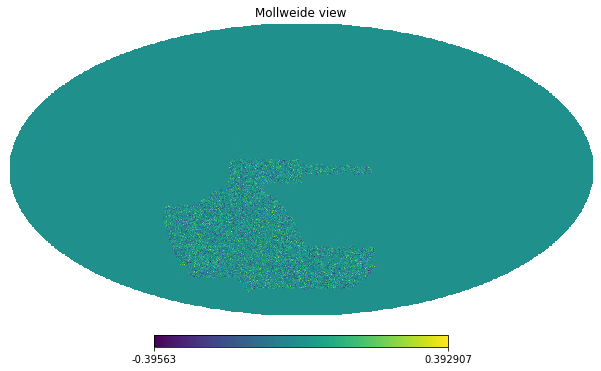

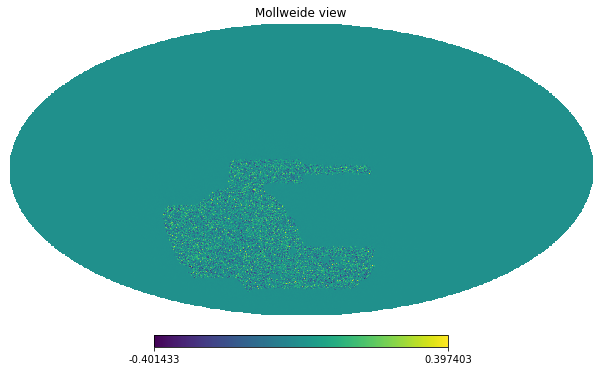

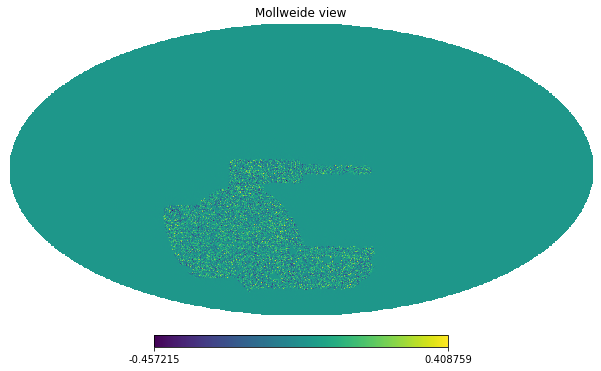

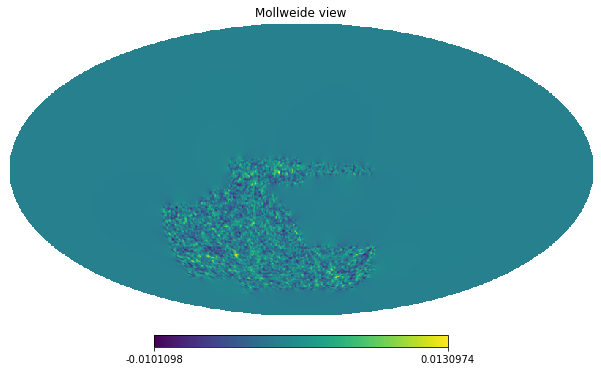

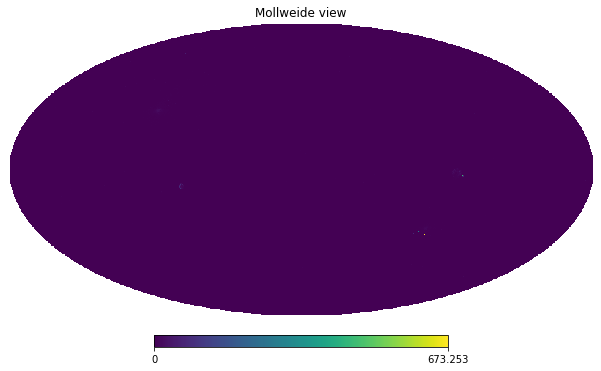

In [3]:
for map in desy3:
    hp.mollview(map)

In [4]:
scale = 25
desy3_1s = hp.sphtfunc.smoothing(map_in=desy3_1, fwhm=((scale/60)/180.*np.pi), sigma=None, beam_window=None, pol=True, iter=3, lmax=None, mmax=None, use_weights=False, use_pixel_weights=False, datapath=None, verbose=True, nest=False)
desy3_2s = hp.sphtfunc.smoothing(map_in=desy3_2, fwhm=((scale/60)/180.*np.pi), sigma=None, beam_window=None, pol=True, iter=3, lmax=None, mmax=None, use_weights=False, use_pixel_weights=False, datapath=None, verbose=True, nest=False)
desy3_3s = hp.sphtfunc.smoothing(map_in=desy3_3, fwhm=((scale/60)/180.*np.pi), sigma=None, beam_window=None, pol=True, iter=3, lmax=None, mmax=None, use_weights=False, use_pixel_weights=False, datapath=None, verbose=True, nest=False)
desy3_4s = hp.sphtfunc.smoothing(map_in=desy3_4, fwhm=((scale/60)/180.*np.pi), sigma=None, beam_window=None, pol=True, iter=3, lmax=None, mmax=None, use_weights=False, use_pixel_weights=False, datapath=None, verbose=True, nest=False)
desy3s = [desy3_1s, desy3_2s, desy3_3s, desy3_4s, ks_full, xray_map]

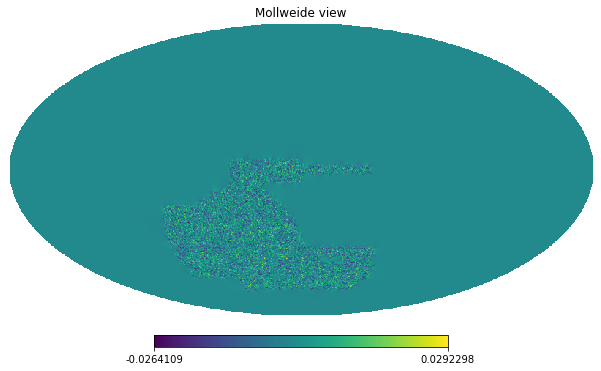

In [5]:
#plot smoothed map
hp.mollview(desy3_1s)


In [6]:
# if you want to save the map:
#hp.write_map('mask_smoothed' + '.fits', desy3_s, overwrite=True)

In [7]:
def DeclRaToIndex(decl,RA):
    return hp.pixelfunc.ang2pix(NSIDE,np.radians(-decl+90.),np.radians(360.-RA))

In [8]:
df = pd.read_csv("mard-y3.dat", sep='\s+')
df = df[df['Z_LFCR'] <= 0.05]#, filter for clusters below 0.05 redshift

[24.52721837584077, -65.10349377051587, 'MARDJ013806.5-650612']
[21.55480848172548, -1.334290113614852, 'MARDJ012613.1-012003']
[18.42874037542566, -65.0356775490094, 'MARDJ011342.8-650208']
[17.71399130374678, -46.00346828122147, 'MARDJ011051.3-460012']
[10.34522347822602, -64.90304076081843, 'MARDJ004122.8-645410']
[12.24522469678086, -64.88590342062288, 'MARDJ004858.8-645309']
[85.54293768806393, -26.19318252138213, 'MARDJ054210.3-261135']
[81.394870131825, -31.7212596207815, 'MARDJ052534.7-314316']
[86.72040506013472, -25.64150551799127, 'MARDJ054652.8-253829']
[13.71499437981093, -1.199811265045557, 'MARDJ005451.5-011159']
[96.90898404696786, -54.31482917753682, 'MARDJ062738.1-541853']
[90.391984195331, -40.22514101969539, 'MARDJ060134.0-401330']
[85.1040334272386, -41.00013640549958, 'MARDJ054024.9-410000']
[67.6662213283561, -53.61529226691061, 'MARDJ043039.8-533655']
[24.36411894604467, -9.20810864071194, 'MARDJ013727.3-091229']
[18.70179219019338, 0.3315970388370817, 'MARDJ011

,NAME,RA_DEG,DEC_DEG,EXPOSURE,CTS,CERR,RATE,ERATE,EXT,EXTERR,EXT_ML,EXI_ML,Z_P1,Z_P2,Z_P3,LAMBDA_P1,LAMBDA_P2,LAMBDA_P3,RA_P1,RA_P2,RA_P3,DEC_P1,DECP_2,DEC_P3,MULTIPLE_FLAG,LUM_P1_CORR,LUM_P2_CORR,LUM_P3_CORR,M500_P1_CORR,M500_P2_CORR,M500_P3_CORR,E_LAMBDA_P1,E_LAMBDA_P2,E_LAMBDA_P3,E_LAMBDA_LFCR,LAMBDA_LFCR,F_CONT_R_P1,F_CONT_R_P2,F_CONT_R_P3,Z_LFCR,F_CONT_LFCR,LUM_LFCR,M500_LFCR_CORR,M500_LFCR,LUM_LFCR_CORR,RA_LFCR,DEC_LFCR,D_SIG_LFCR,DFC_LFCR
2055,MARDJ013806.5-650612,24.527218,-65.103494,262.080963,16.753017,4.955101,0.063923,0.018907,0.000000,0.000000,0.000000,18.977661,0.015000,0.780000,0.072475,12.392427,10.411980,5.936822,25.097848,24.038095,24.383317,-64.681997,-65.159811,-65.049034,0,0.034326,20.717401,0.373199,6.146286e+13,1.056689e+15,2.076306e+14,2.304308,4.497593,3.463267,2.304308,12.392427,0.158237,0.795726,0.374381,0.015000,0.158237,0.004949,6.146286e+13,2.283808e+13,0.034326,25.166709,-64.707549,-3.649704,0.216144
475,MARDJ012613.1-012003,21.554808,-1.334290,432.736755,22.549690,5.948507,0.052109,0.013746,0.000000,0.000000,0.000000,17.430969,0.015000,0.555120,-0.100000,10.679475,6.266969,-0.100000,361.000000,361.000000,361.000000,91.000000,91.000000,91.000000,1,0.031610,8.758209,0.000000,5.904024e+13,8.036914e+14,0.000000e+00,1.697207,4.297501,-0.100000,1.697207,10.679475,0.190428,0.752342,99.000000,0.015000,0.190428,0.004558,5.904024e+13,2.187329e+13,0.031610,21.246461,-0.958953,-99.900000,0.561914
2093,MARDJ011342.8-650208,18.428740,-65.035678,175.478897,6.321820,3.169120,0.036026,0.018060,0.000000,0.000000,0.000000,7.551910,0.015000,0.154950,-0.100000,10.584115,3.515303,-0.100000,18.522839,361.000000,361.000000,-65.052301,91.000000,91.000000,0,0.017993,0.615390,0.000000,4.278918e+13,2.479761e+14,0.000000e+00,1.757119,2.120708,-0.100000,1.757119,10.584115,0.170469,0.523430,99.000000,0.015000,0.170469,0.002594,4.278918e+13,1.628488e+13,0.017993,18.095725,-65.466177,-4.476115,0.352961
2075,MARDJ011051.3-460012,17.713991,-46.003468,313.561371,26.015104,6.121724,0.082967,0.019523,0.000000,0.000000,0.000000,27.496216,0.015000,1.300622,0.415912,17.822030,5.661142,4.446257,17.449391,17.895613,17.813044,-45.893831,-46.050701,-45.971352,1,0.037032,72.551780,5.183277,6.427252e+13,1.469162e+15,6.758968e+14,2.160236,16.890959,3.346773,2.160236,17.822030,0.074926,0.981562,0.712872,0.015000,0.074926,0.005340,6.427252e+13,2.376356e+13,0.037032,17.474140,-45.908106,-3.856660,0.637946
476,MARDJ012541.9-012129,21.424659,-1.358127,432.722229,15.295616,5.190590,0.035347,0.011995,0.000000,0.000000,0.000000,12.114685,0.015000,0.161950,-0.100000,9.485397,3.752292,-0.100000,21.480167,21.462009,21.414076,-1.301905,-1.403168,-1.418488,1,0.021442,0.788569,0.000000,4.787108e+13,2.907210e+14,0.000000e+00,1.598730,2.226134,-0.100000,1.598730,9.485397,0.199436,0.518740,99.000000,0.015000,0.199436,0.003092,4.787108e+13,1.785100e+13,0.021442,21.455206,-1.353485,-99.900000,0.319304
477,MARDJ012605.7-012140,21.523892,-1.361377,432.701111,26.852446,6.396112,0.062058,0.014782,0.000000,0.000000,0.000000,22.519714,0.015000,0.544520,-0.100000,10.864131,4.538574,-0.100000,361.000000,361.000000,361.000000,91.000000,91.000000,91.000000,1,0.037645,9.976747,0.000000,6.481178e+13,8.708778e+14,0.000000e+00,1.715444,4.177846,-0.100000,1.715444,10.864131,0.193576,0.784775,99.000000,0.015000,0.193576,0.005428,6.481178e+13,2.396870e+13,0.037645,21.460570,-1.351789,-99.900000,0.591199
478,MARDJ012529.1-012408,21.371467,-1.402235,433.104828,10.297523,4.301771,0.023776,0.009932,0.000000,0.000000,0.000000,9.495117,0.015000,-0.100000,-0.100000,9.708848,-0.100000,-0.100000,21.460540,21.414249,21.478365,-1.401440,-1.423935,-1.433725,1,0.014423,0.000000,0.000000,3.857180e+13,0.000000e+00,0.000000e+00,1.609096,-0.100000,-0.100000,1.609096,9.708848,0.173263,99.000000,99.000000,0.015000,0.173263,0.002080,3.857180e+13,1.450435e+13,0.014423,21.449273,-1.350136,-99.900000,98.826737
479,MARDJ012537.4-012623,21.405932,-1.439926,433.448242,13.217669,4.993875,0.030494,0.01152

<AxesSubplot:xlabel='M500_LFCR', ylabel='LUM_LFCR'>

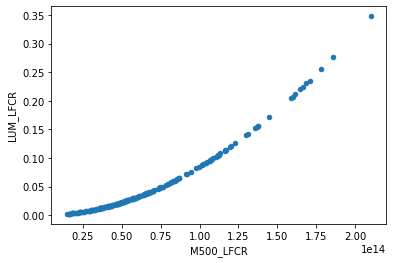

In [9]:
df1 = df.sort_values(by=['Z_LFCR'], ascending=True)#.head(10)
coords = []
for index, row in df1.iterrows():
    if len(coords) == 0:
        coords.append([row['RA_DEG'],row['DEC_DEG'],row['NAME']])
    else:
        l = len(coords)
        add = True
        for i in range(l):
            if (row['RA_DEG'] - coords[i][0])**2 + (row['DEC_DEG'] - coords[i][1])**2 < 1:
                add = False
        if add:
            coords.append([row['RA_DEG'],row['DEC_DEG'],row['NAME']])
            
for coord in coords:
    print(coord)

display(HTML(df1.to_html()))
df.plot.scatter(y='LUM_LFCR',x='M500_LFCR')

17.47414 -45.908106 0.015 63.077490001779715 Mpc 4.541317362971559
85.530846 -26.136223 0.018347 76.84006787760478 Mpc 3.728038429990113
86.372968 -25.932611 0.0237 98.61971140819753 Mpc 2.9047852159379217
14.106606 -1.262439 0.02435 101.24513289366651 Mpc 2.829465220308135


/Users/dylanjackaway/.local/lib/python3.8/site-packages/healpy/visufunc.py:764: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f = pylab.figure(fig, figsize=(8.5, 5.4))


90.171272 -40.04455 0.02545 105.67873478973121 Mpc 2.7107662483185173
85.058976 -40.774272 0.029355 121.32289527815242 Mpc 2.361239480366851
67.128295 -53.737908 0.03246 133.65696850469638 Mpc 2.1433491680376386
24.314049 -9.19755 0.03249 133.77568698259049 Mpc 2.1414471358093126
30.572022 -1.127824 0.03495 143.48136164392335 Mpc 1.9965956266931837
19.050879 -15.909564 0.034988 143.63083463162184 Mpc 1.994517887150033
327.874574 -55.336878 0.0366 149.95901740410918 Mpc 1.910352949664977
14.365076 -0.471532 0.03745 153.285933142629 Mpc 1.868891865506287
17.07088 2.185914 0.037468 153.35631169446145 Mpc 1.8680342146382514
75.36838 -22.610385 0.038172 156.10649826093857 Mpc 1.8351252655524395
89.355186 -37.524019 0.03821 156.25481296894165 Mpc 1.8333834399554647
17.197097 -15.415016 0.038855 158.77018681252625 Mpc 1.804338177096584
19.723404 -1.001982 0.039207 160.1412679941996 Mpc 1.7888903817545296
337.149526 -60.801356 0.039955 163.05095335042697 Mpc 1.7569679897975263
303.112942 -56.8

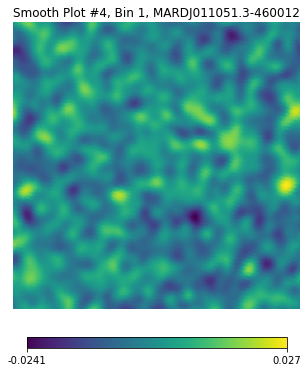

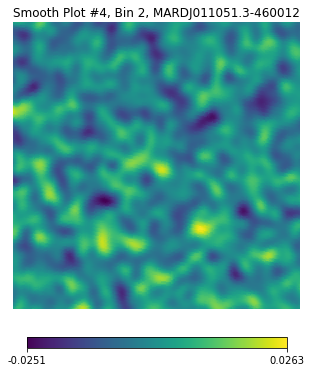

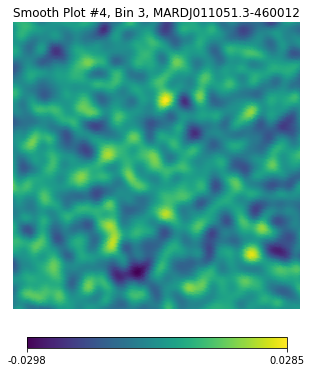

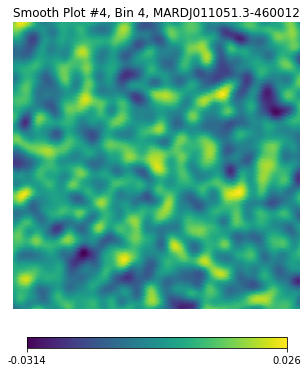

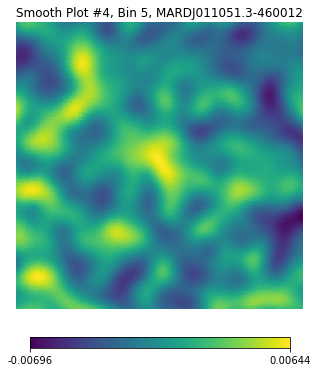

...

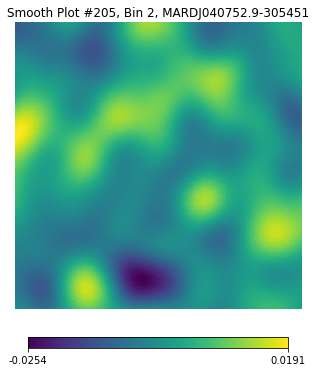

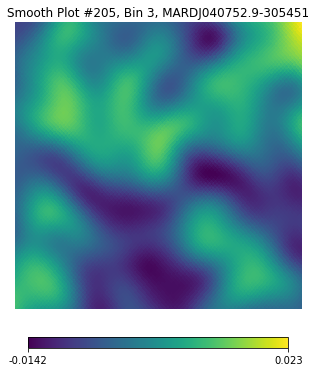

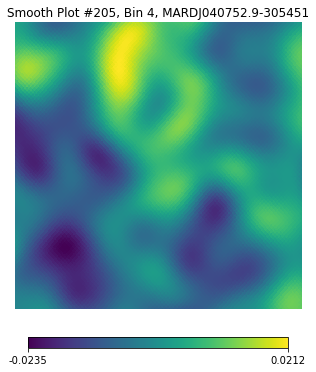

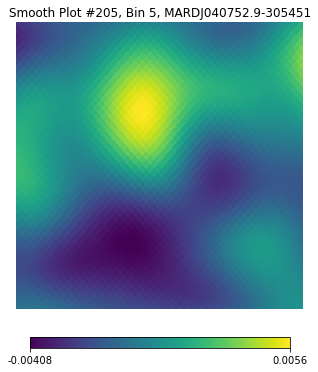

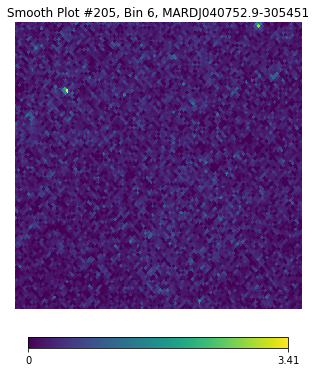

In [10]:
cosmo = FlatLambdaCDM(H0=70 * u.km / u.s / u.Mpc, Tcmb0=2.725 * u.K, Om0=0.3)
namelist = np.array(coords)[:, 2]

for n in range(len(df1)):
    if (n+1) in [1, 2, 3, 12, 14, 24, 27, 47, 50, 70, 72, 166, 181, 185, 193, 211] or (df1.iloc[n,0] not in namelist):
        continue
    
    ra_deg = df1.iloc[n,45]
    dec_deg = df1.iloc[n,46]
    
    
    z_lfcr = df1.iloc[n,39]
    dist = cosmo.angular_diameter_distance(z_lfcr)

    zoom = 5*np.degrees(np.arctan2(1, dist / u.Mpc)).value
    NSIDE = hp.pixelfunc.get_nside(desy3_1)
    print(ra_deg, dec_deg, z_lfcr, dist, zoom)
    for i in range(min(3, int(np.floor(5*z_lfcr))), len(desy3s)):
        #hp.cartview(desy3[i], rot=[ra_deg,dec_deg], lonra=[-zoom,zoom], latra=[-zoom,zoom], title = "Raw Plot #"+str(n+1)+", Bin "+str(i+1))
        hp.cartview(desy3s[i], rot=[ra_deg,dec_deg], lonra=[-zoom,zoom], latra=[-zoom,zoom], title = "Smooth Plot #"+str(n+1)+", Bin "+str(i+1)+", "+df1.iloc[n,0])
    """hp.cartview(desy3_1s, rot=[ra_deg,dec_deg], lonra=[-zoom,zoom], latra=[-zoom,zoom])
    hp.cartview(desy3_2s, rot=[ra_deg,dec_deg], lonra=[-zoom,zoom], latra=[-zoom,zoom])
    hp.cartview(desy3_3s, rot=[ra_deg,dec_deg], lonra=[-zoom,zoom], latra=[-zoom,zoom])
    hp.cartview(desy3_4s, rot=[ra_deg,dec_deg], lonra=[-zoom,zoom], latra=[-zoom,zoom])"""

In [11]:
hp.pixelfunc.nside2resol(512, arcmin=True)

6.870972823634812

In [12]:
import matplotlib.image as mpimg
image = mpimg.imread("DES0057-0124_r4907p02_irg.tiff")
#pts = np.array([[330,620],[950,620],[692,450],[587,450]])

/Users/dylanjackaway/opt/anaconda3/lib/python3.8/site-packages/PIL/Image.py:3035: DecompressionBombWarning: Image size (100000000 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


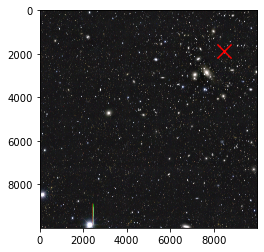

In [13]:
plt.imshow(image)
plt.scatter((1 - (14.106606 - 13.895254)*(14.626063 - 13.895254))*10000, (-1.262439 + 1.776311)*(-1.411111 + 1.776311)*10000, marker="x", color="red", s=200)
plt.show()